In [1]:
import os
import sys
import time
import io

import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms.functional as TF
import torch.utils.data as tdata
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

from tqdm.notebook import tqdm
import wandb

In [2]:
from anime_face_generator.config import PROCESSED_DATA_DIR, RAW_DATA_DIR, MODELS_DIR
import anime_face_generator.modeling.models.giga_unet_edited_ddpm_85M as Giga
from anime_face_generator.modeling.train2 import train_model

%load_ext autoreload
%autoreload 2

2025-08-10 18:06:00.529 | INFO     | anime_face_generator.config:<module>:11 - PROJ_ROOT path is: /home/ayoubvip/anime_face_generator


![Algorithm1](https://learnopencv.com/wp-content/uploads/2023/02/denoising-diffusion-probabilistic-models_DDPM_trainig_inference_algorithm-1024x247.png)

In [3]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")
print("number of GPUs:", torch.cuda.device_count())

Using device: cuda
number of GPUs: 2


## Data augmentation

In [4]:
transformers = torchvision.transforms.Compose([
    torchvision.transforms.Resize(size=Giga.ModelParams.im_size),
    torchvision.transforms.RandomHorizontalFlip(),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
])

dataset = torchvision.datasets.ImageFolder(root=PROCESSED_DATA_DIR, transform=transformers, target_transform=None)

In [5]:
rand_gen = torch.Generator().manual_seed(1978)

## Unet Denoiser Architecture

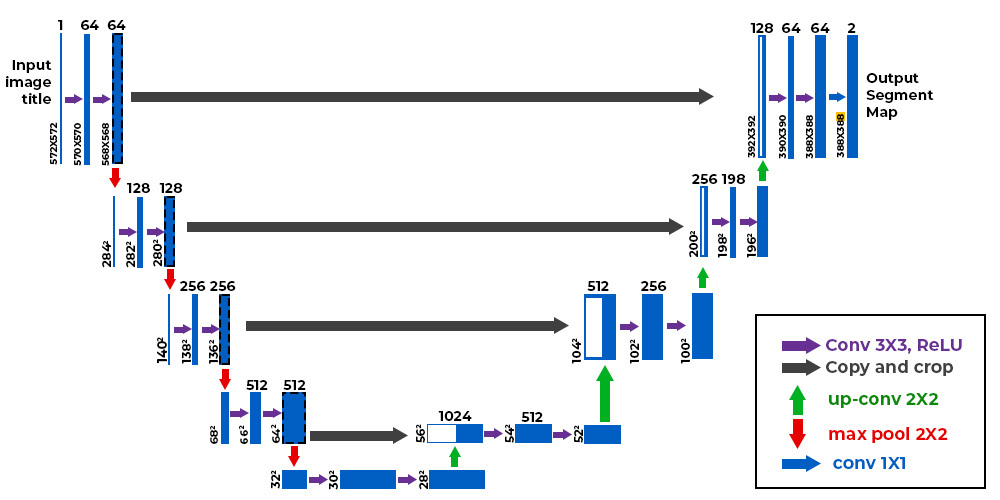

wandb: ERROR Failed to detect the name of this notebook. You can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: ayoub-dev2000 (ayoub-dev2000-university-of-liege) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


---------------------------------------------
 EPOCH 1
---------------------------------------------
train loss: 1.109914  [    6/72454]
val loss: 1.067769  [    6/72454]
timestep in first x in the batch:  429


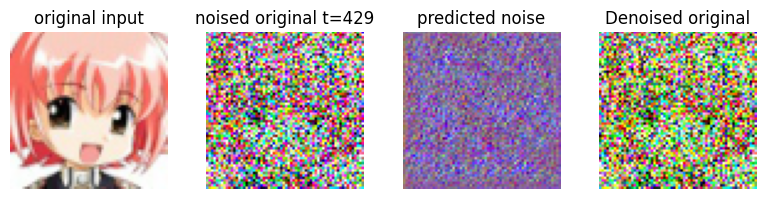

train loss: 0.077841  [ 4806/72454]
val loss: 0.073857  [ 4806/72454]
timestep in first x in the batch:  168


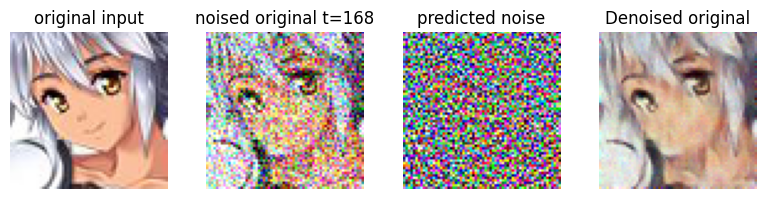

train loss: 0.011348  [ 9606/72454]
val loss: 0.043192  [ 9606/72454]
timestep in first x in the batch:  381


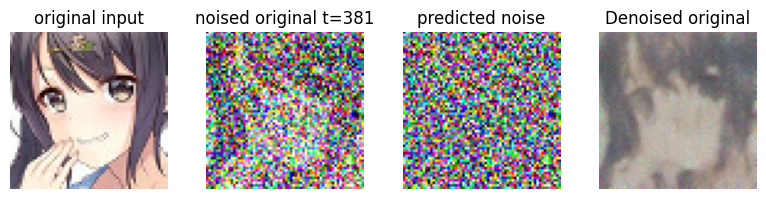

train loss: 0.027398  [14406/72454]
val loss: 0.040034  [14406/72454]
timestep in first x in the batch:  131


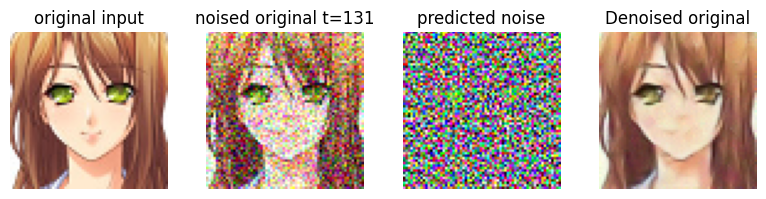

train loss: 0.020879  [19206/72454]
val loss: 0.040171  [19206/72454]
timestep in first x in the batch:  329


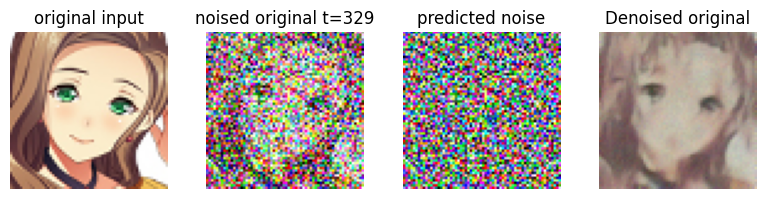

train loss: 0.008182  [24006/72454]
val loss: 0.038893  [24006/72454]
timestep in first x in the batch:  736


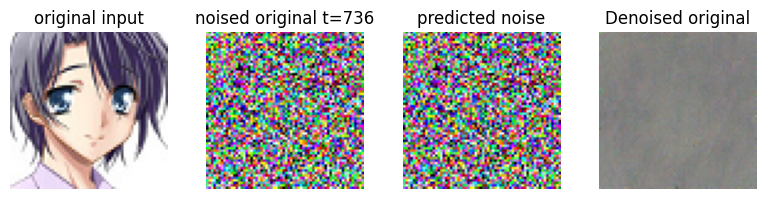

train loss: 0.077134  [28806/72454]
val loss: 0.035612  [28806/72454]
timestep in first x in the batch:  70


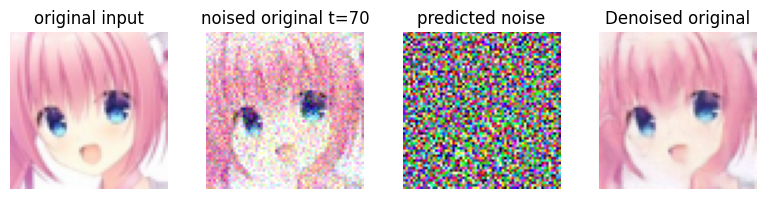

train loss: 0.030122  [33606/72454]
val loss: 0.033292  [33606/72454]
timestep in first x in the batch:  223


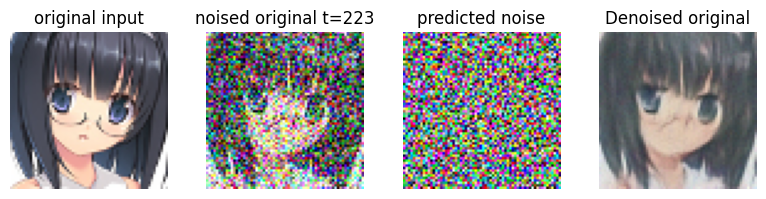

train loss: 0.031229  [38406/72454]
val loss: 0.038224  [38406/72454]
timestep in first x in the batch:  992


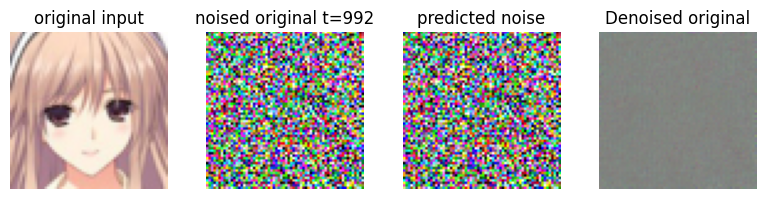

train loss: 0.028424  [43206/72454]
val loss: 0.035157  [43206/72454]
timestep in first x in the batch:  159


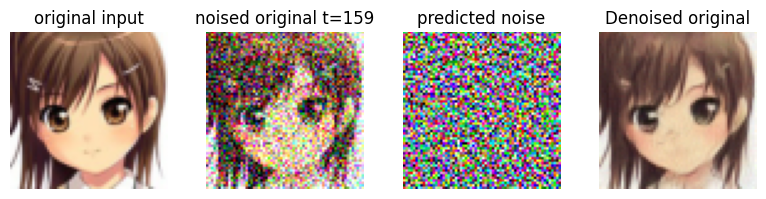

train loss: 0.006668  [48006/72454]
val loss: 0.033210  [48006/72454]
timestep in first x in the batch:  310


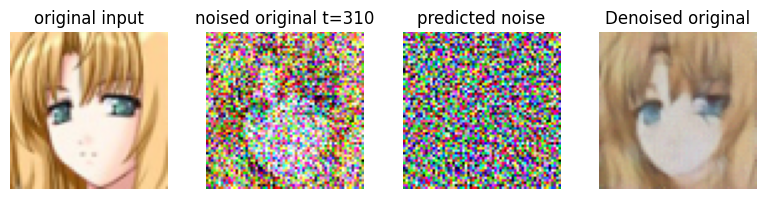

train loss: 0.025658  [52806/72454]
val loss: 0.033089  [52806/72454]
timestep in first x in the batch:  577


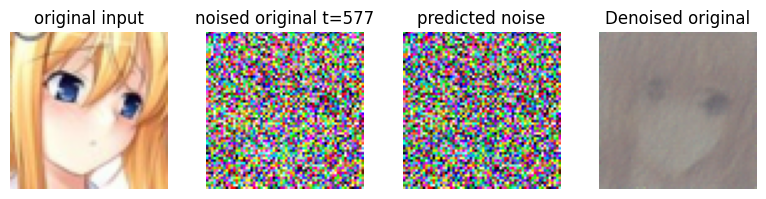

train loss: 0.027870  [57606/72454]
val loss: 0.032563  [57606/72454]
timestep in first x in the batch:  471


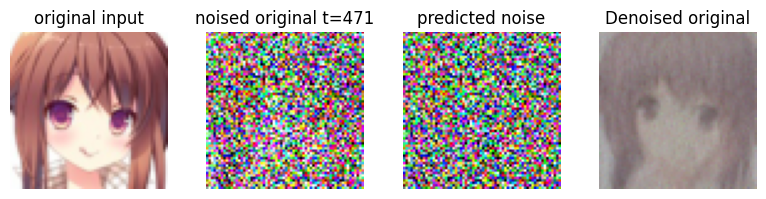

train loss: 0.021012  [62406/72454]
val loss: 0.031988  [62406/72454]
timestep in first x in the batch:  268


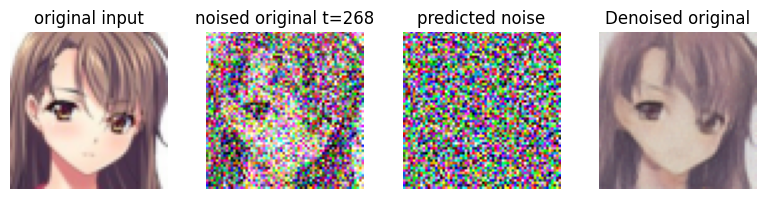

train loss: 0.039963  [67206/72454]
val loss: 0.032547  [67206/72454]
timestep in first x in the batch:  181


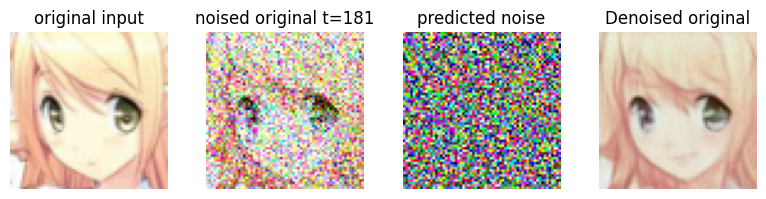

train loss: 0.011014  [72006/72454]
val loss: 0.030738  [72006/72454]
timestep in first x in the batch:  888


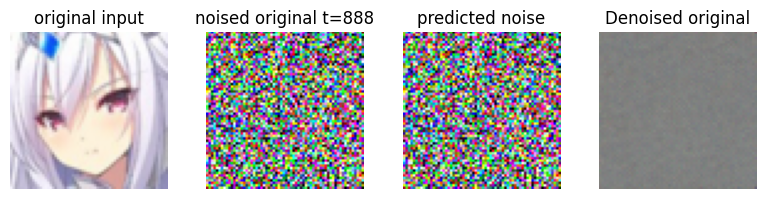

Epoch 1 finished
Model saved as 85M_params_GIGA_DDPM_Unet_ckpt_epoch_1.pth
---------------------------------------------
 EPOCH 2
---------------------------------------------
train loss: 0.027311  [    6/72454]
val loss: 0.030689  [    6/72454]
timestep in first x in the batch:  934


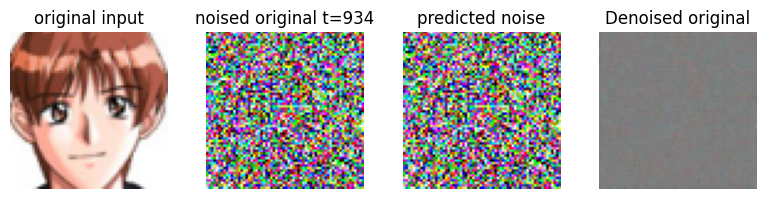

train loss: 0.021808  [ 4806/72454]
val loss: 0.026146  [ 4806/72454]
timestep in first x in the batch:  180


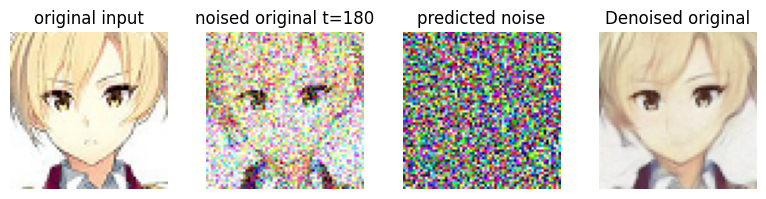

train loss: 0.046437  [ 9606/72454]
val loss: 0.033942  [ 9606/72454]
timestep in first x in the batch:  952


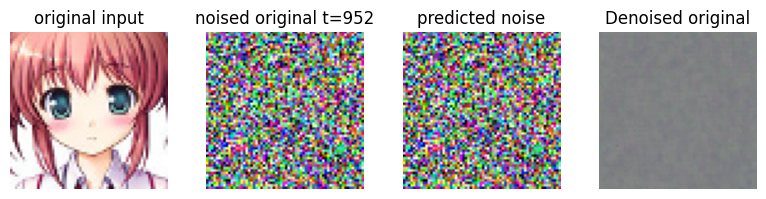

train loss: 0.012156  [14406/72454]
val loss: 0.033688  [14406/72454]
timestep in first x in the batch:  338


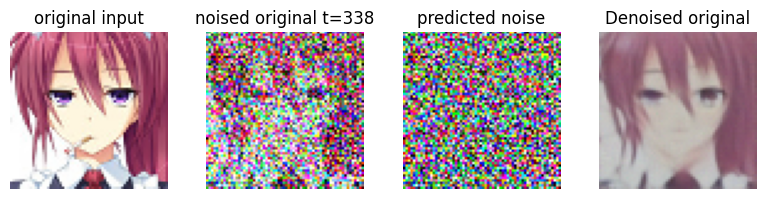

train loss: 0.013922  [19206/72454]
val loss: 0.031190  [19206/72454]
timestep in first x in the batch:  336


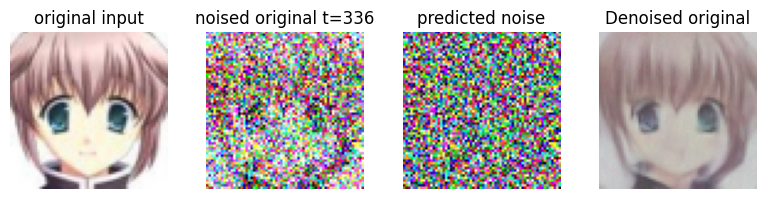

train loss: 0.013592  [24006/72454]
val loss: 0.032191  [24006/72454]
timestep in first x in the batch:  7


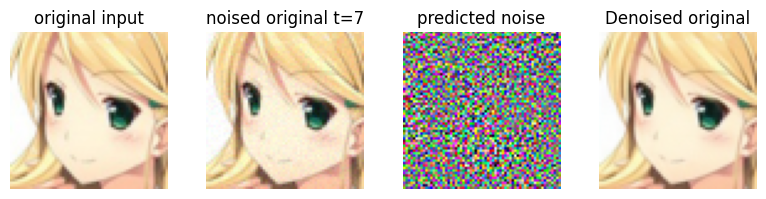

train loss: 0.038926  [28806/72454]
val loss: 0.034129  [28806/72454]
timestep in first x in the batch:  363


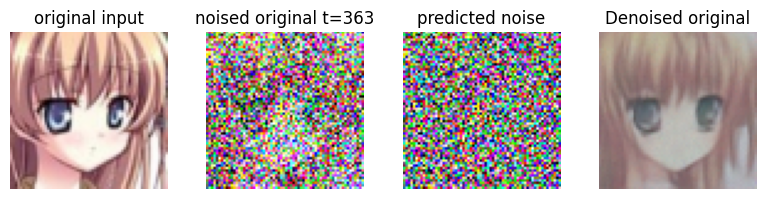

train loss: 0.125525  [33606/72454]
val loss: 0.030512  [33606/72454]
timestep in first x in the batch:  930


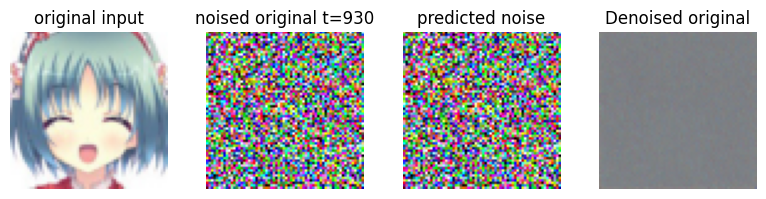

train loss: 0.037382  [38406/72454]
val loss: 0.026962  [38406/72454]
timestep in first x in the batch:  68


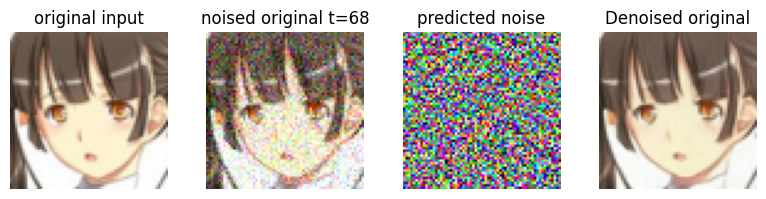

train loss: 0.020200  [43206/72454]
val loss: 0.032268  [43206/72454]
timestep in first x in the batch:  187


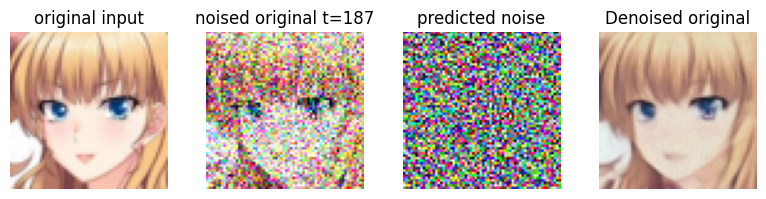

train loss: 0.018564  [48006/72454]
val loss: 0.029445  [48006/72454]
timestep in first x in the batch:  842


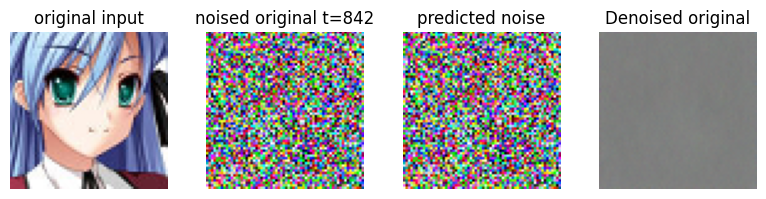

train loss: 0.094092  [52806/72454]
val loss: 0.024522  [52806/72454]
timestep in first x in the batch:  737


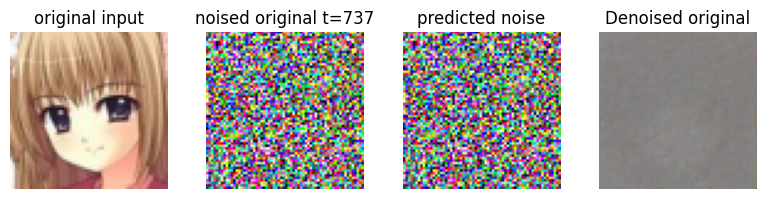

train loss: 0.035339  [57606/72454]
val loss: 0.032787  [57606/72454]
timestep in first x in the batch:  689


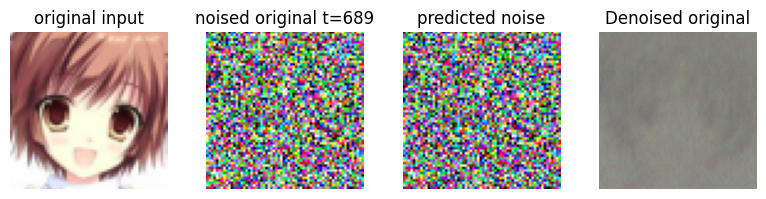

train loss: 0.119844  [62406/72454]
val loss: 0.032737  [62406/72454]
timestep in first x in the batch:  741


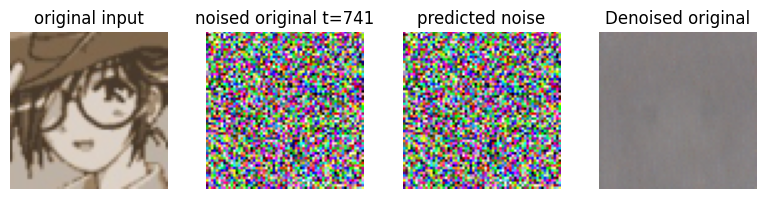

train loss: 0.044161  [67206/72454]
val loss: 0.030963  [67206/72454]
timestep in first x in the batch:  355


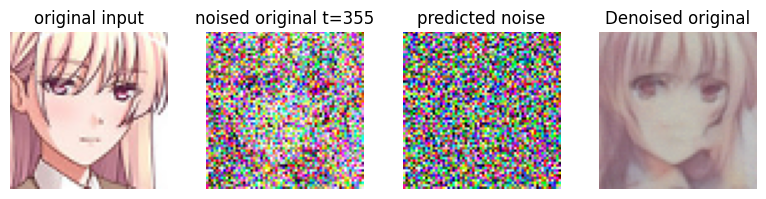

train loss: 0.032568  [72006/72454]
val loss: 0.028658  [72006/72454]
timestep in first x in the batch:  100


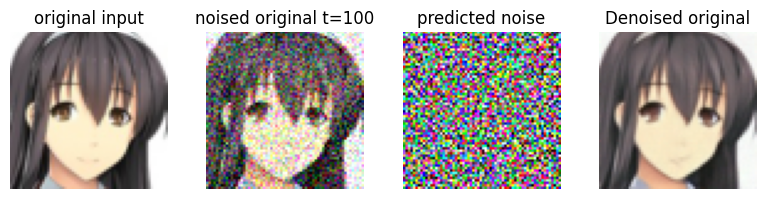

Epoch 2 finished
Model saved as 85M_params_GIGA_DDPM_Unet_ckpt_epoch_2.pth
---------------------------------------------
 EPOCH 3
---------------------------------------------
train loss: 0.020260  [    6/72454]
val loss: 0.030580  [    6/72454]
timestep in first x in the batch:  615


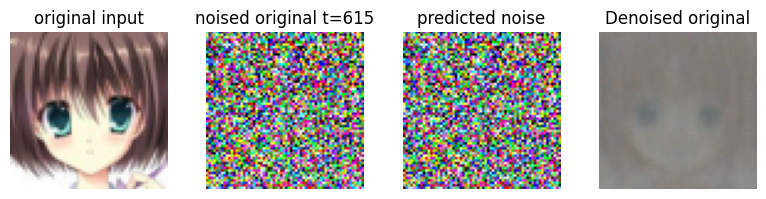

train loss: 0.020569  [ 4806/72454]
val loss: 0.028411  [ 4806/72454]
timestep in first x in the batch:  660


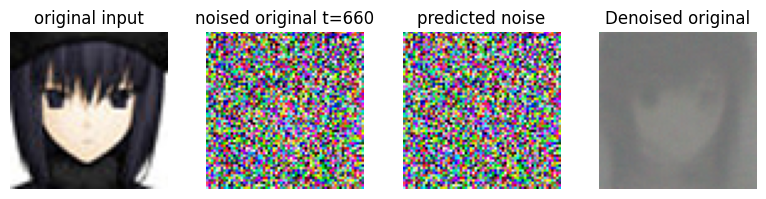

train loss: 0.029057  [ 9606/72454]
val loss: 0.024560  [ 9606/72454]
timestep in first x in the batch:  240


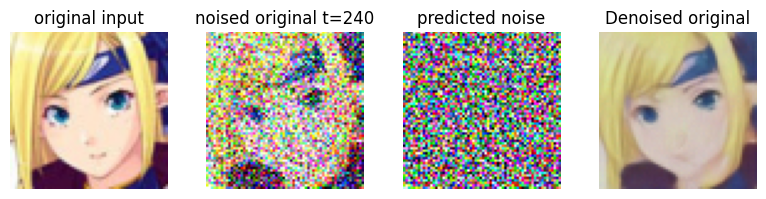

train loss: 0.050635  [14406/72454]
val loss: 0.028684  [14406/72454]
timestep in first x in the batch:  295


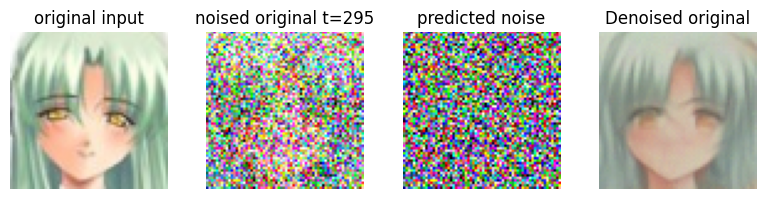

train loss: 0.048223  [19206/72454]
val loss: 0.027167  [19206/72454]
timestep in first x in the batch:  469


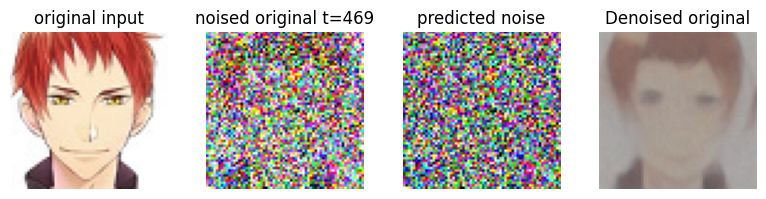

train loss: 0.044974  [24006/72454]
val loss: 0.029230  [24006/72454]
timestep in first x in the batch:  34


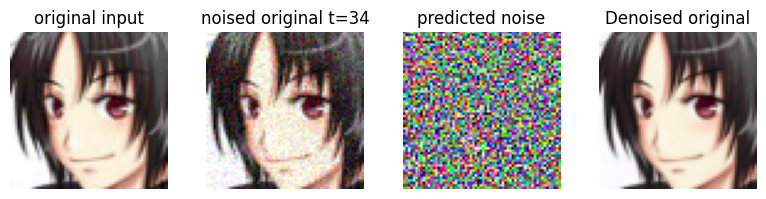

train loss: 0.039077  [28806/72454]
val loss: 0.027092  [28806/72454]
timestep in first x in the batch:  140


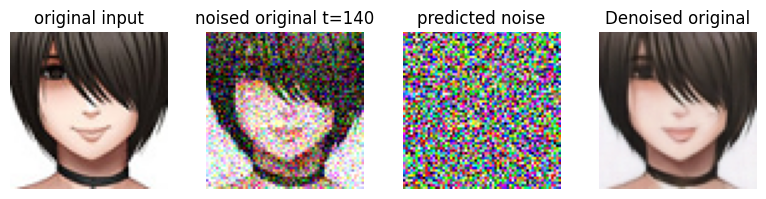

train loss: 0.005082  [38406/72454]
val loss: 0.025814  [38406/72454]
timestep in first x in the batch:  974


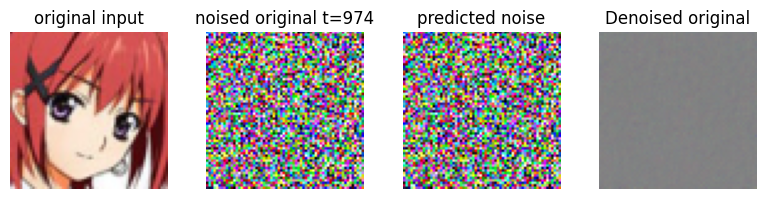

train loss: 0.048669  [43206/72454]
val loss: 0.026224  [43206/72454]
timestep in first x in the batch:  836


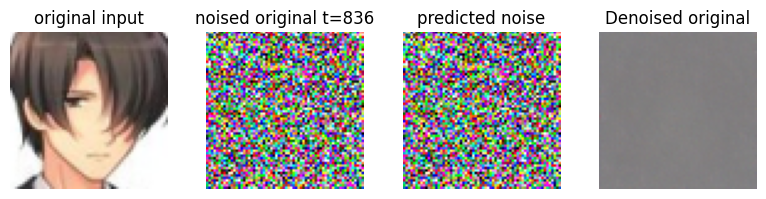

train loss: 0.049030  [48006/72454]
val loss: 0.024580  [48006/72454]
timestep in first x in the batch:  750


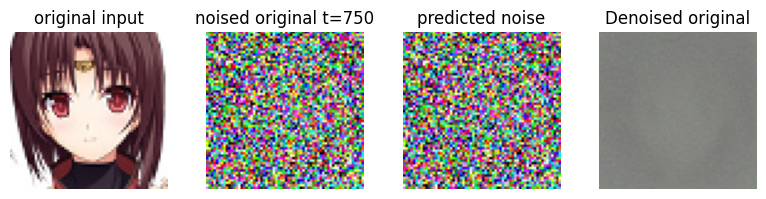

train loss: 0.011668  [52806/72454]
val loss: 0.026014  [52806/72454]
timestep in first x in the batch:  437


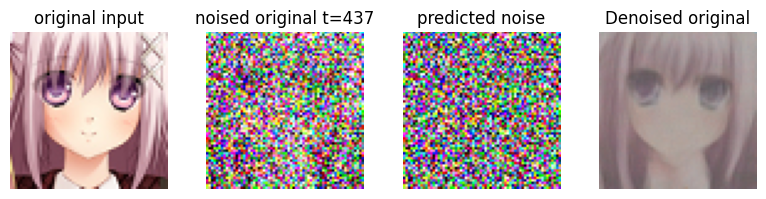

train loss: 0.007645  [57606/72454]
val loss: 0.026696  [57606/72454]
timestep in first x in the batch:  733


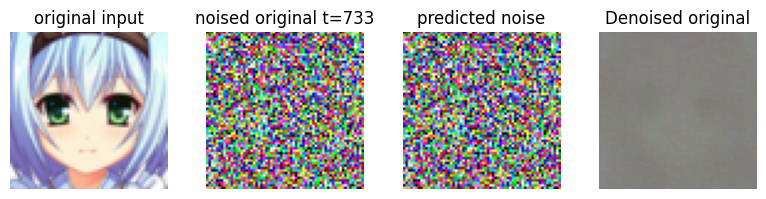

train loss: 0.018260  [62406/72454]
val loss: 0.028236  [62406/72454]
timestep in first x in the batch:  808


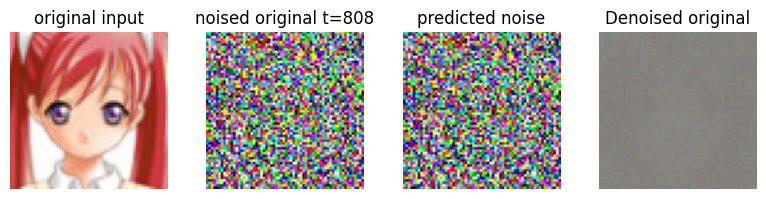

train loss: 0.014315  [67206/72454]
val loss: 0.029951  [67206/72454]
timestep in first x in the batch:  676


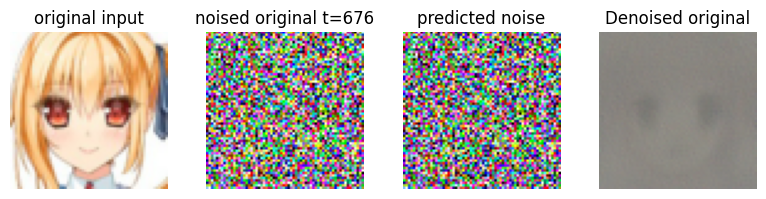

train loss: 0.022038  [72006/72454]
val loss: 0.033199  [72006/72454]
timestep in first x in the batch:  337


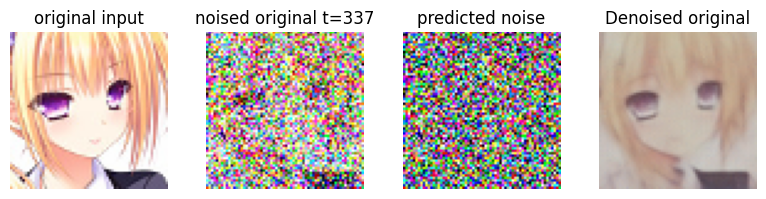

Epoch 3 finished
Model saved as 85M_params_GIGA_DDPM_Unet_ckpt_epoch_3.pth
---------------------------------------------
 EPOCH 4
---------------------------------------------
train loss: 0.008547  [    6/72454]
val loss: 0.029011  [    6/72454]
timestep in first x in the batch:  184


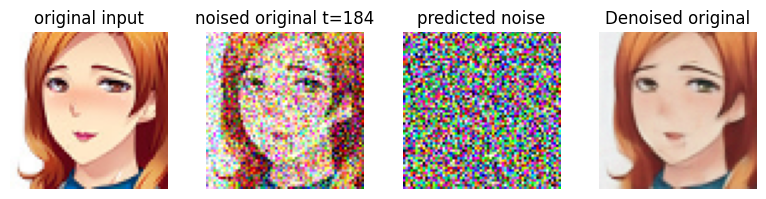

train loss: 0.034488  [ 4806/72454]
val loss: 0.028411  [ 4806/72454]
timestep in first x in the batch:  588


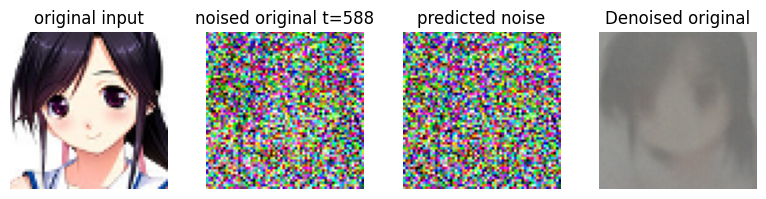

train loss: 0.004640  [ 9606/72454]
val loss: 0.028389  [ 9606/72454]
timestep in first x in the batch:  461


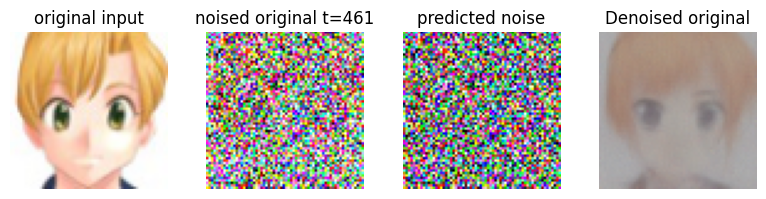

train loss: 0.014033  [14406/72454]
val loss: 0.028893  [14406/72454]
timestep in first x in the batch:  820


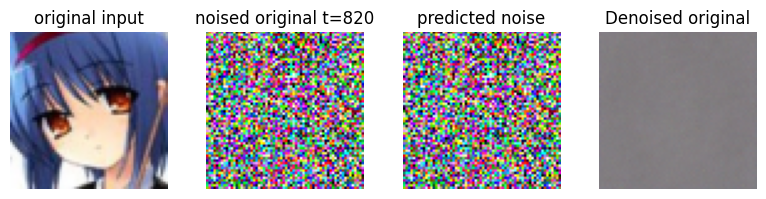

train loss: 0.017619  [19206/72454]
val loss: 0.026194  [19206/72454]
timestep in first x in the batch:  628


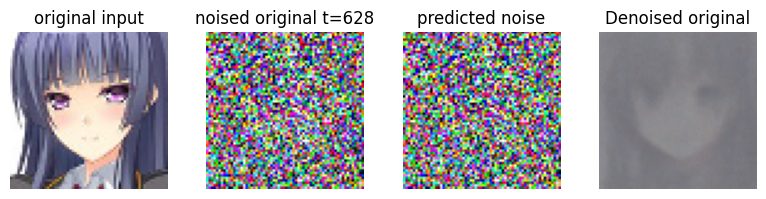

train loss: 0.047188  [24006/72454]
val loss: 0.030652  [24006/72454]
timestep in first x in the batch:  697


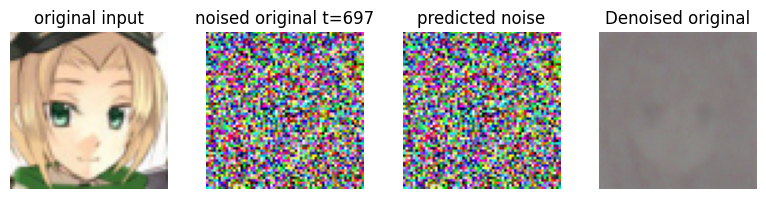

train loss: 0.070318  [28806/72454]
val loss: 0.024878  [28806/72454]
timestep in first x in the batch:  453


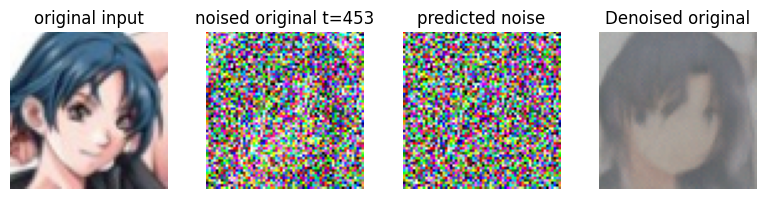

train loss: 0.005355  [33606/72454]
val loss: 0.029199  [33606/72454]
timestep in first x in the batch:  341


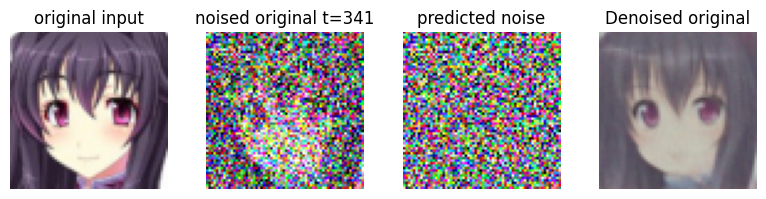

train loss: 0.099156  [38406/72454]
val loss: 0.027046  [38406/72454]
timestep in first x in the batch:  427


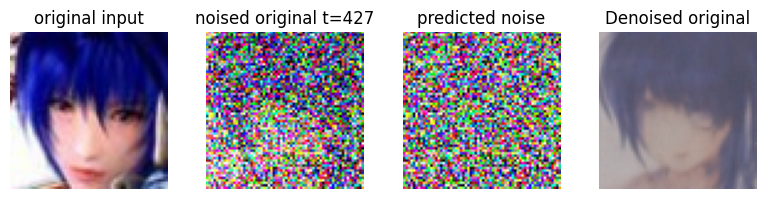

train loss: 0.024399  [43206/72454]
val loss: 0.025720  [43206/72454]
timestep in first x in the batch:  931


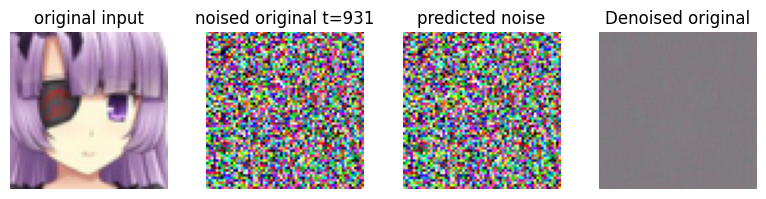

train loss: 0.056449  [48006/72454]
val loss: 0.023837  [48006/72454]
timestep in first x in the batch:  940


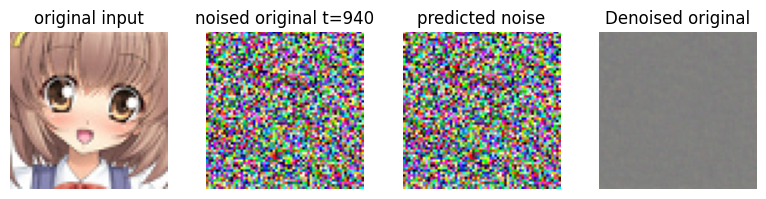

train loss: 0.004709  [52806/72454]
val loss: 0.026901  [52806/72454]
timestep in first x in the batch:  673


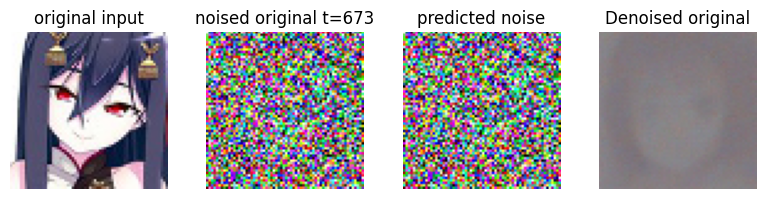

train loss: 0.028634  [57606/72454]
val loss: 0.026236  [57606/72454]
timestep in first x in the batch:  589


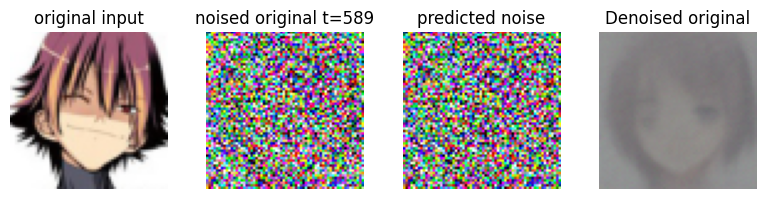

train loss: 0.016414  [62406/72454]
val loss: 0.028831  [62406/72454]
timestep in first x in the batch:  758


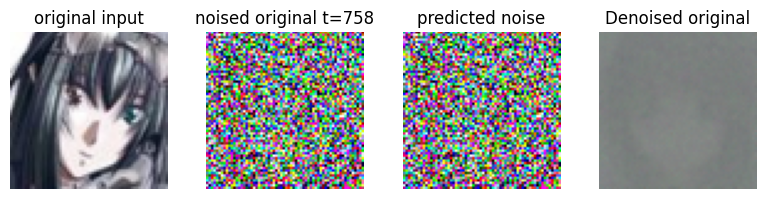

train loss: 0.038701  [67206/72454]
val loss: 0.025641  [67206/72454]
timestep in first x in the batch:  725


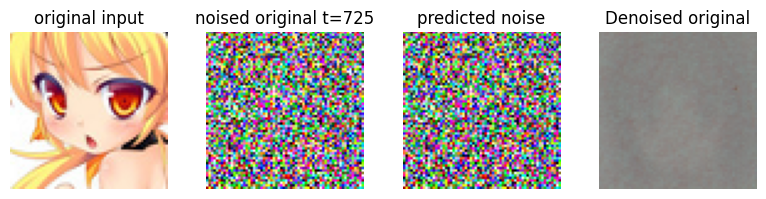

train loss: 0.042377  [72006/72454]
val loss: 0.026882  [72006/72454]
timestep in first x in the batch:  326


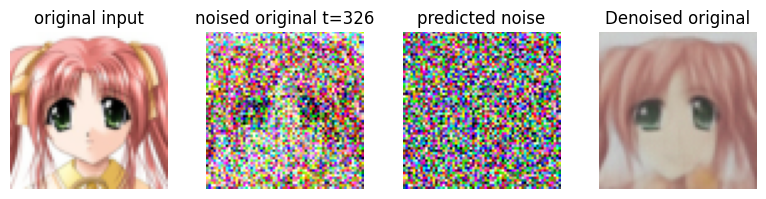

Epoch 4 finished
Model saved as 85M_params_GIGA_DDPM_Unet_ckpt_epoch_4.pth
---------------------------------------------
 EPOCH 5
---------------------------------------------
train loss: 0.033096  [    6/72454]
val loss: 0.028291  [    6/72454]
timestep in first x in the batch:  533


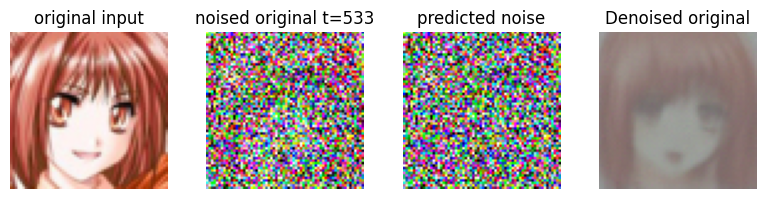

train loss: 0.008742  [ 4806/72454]
val loss: 0.028230  [ 4806/72454]
timestep in first x in the batch:  41


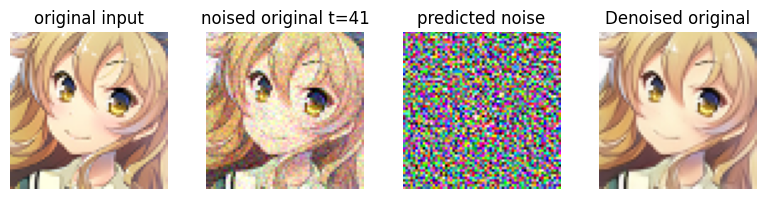

train loss: 0.018847  [ 9606/72454]
val loss: 0.027028  [ 9606/72454]
timestep in first x in the batch:  770


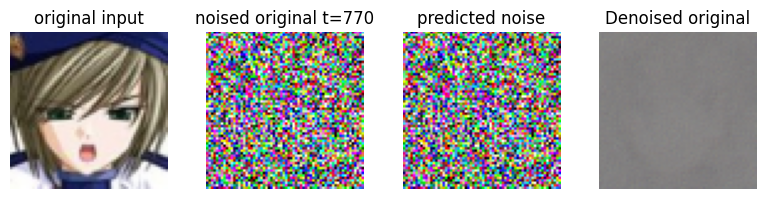

train loss: 0.020098  [14406/72454]
val loss: 0.027045  [14406/72454]
timestep in first x in the batch:  182


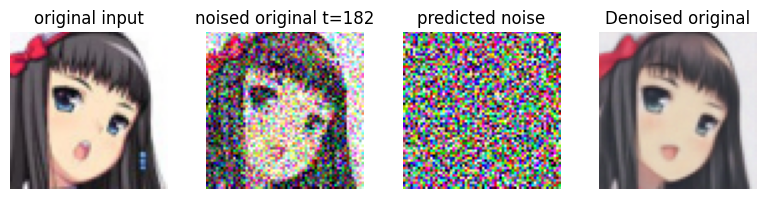

train loss: 0.014538  [19206/72454]
val loss: 0.026986  [19206/72454]
timestep in first x in the batch:  597


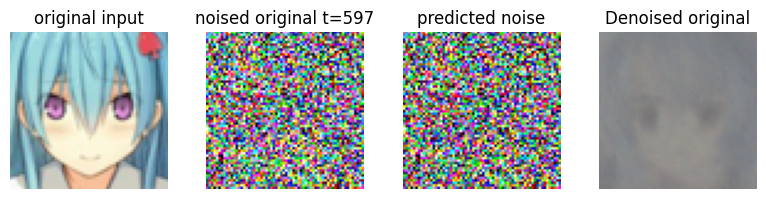

train loss: 0.075724  [24006/72454]
val loss: 0.026456  [24006/72454]
timestep in first x in the batch:  164


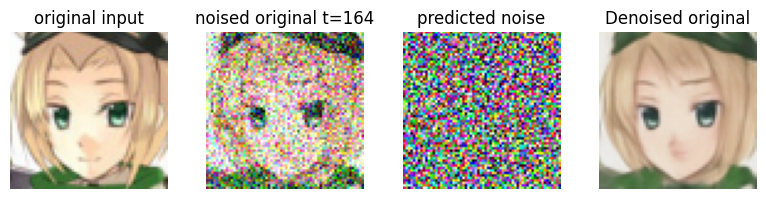

train loss: 0.008605  [28806/72454]
val loss: 0.028050  [28806/72454]
timestep in first x in the batch:  760


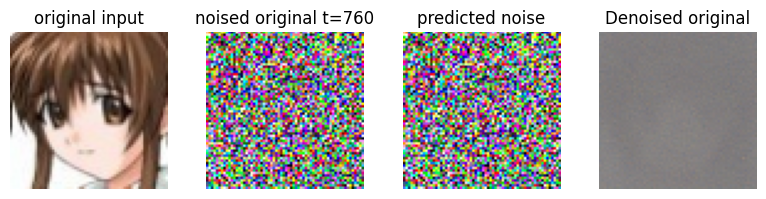

train loss: 0.026149  [33606/72454]
val loss: 0.027787  [33606/72454]
timestep in first x in the batch:  594


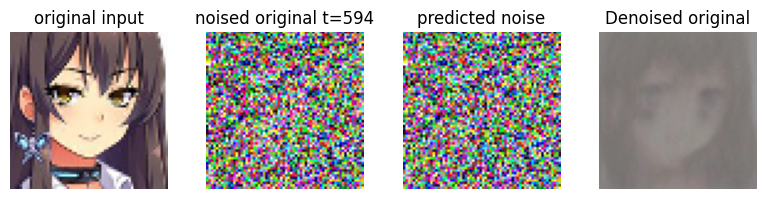

train loss: 0.015145  [38406/72454]
val loss: 0.026718  [38406/72454]
timestep in first x in the batch:  480


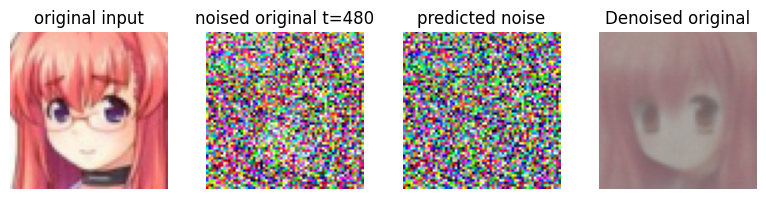

train loss: 0.021335  [43206/72454]
val loss: 0.028297  [43206/72454]
timestep in first x in the batch:  31


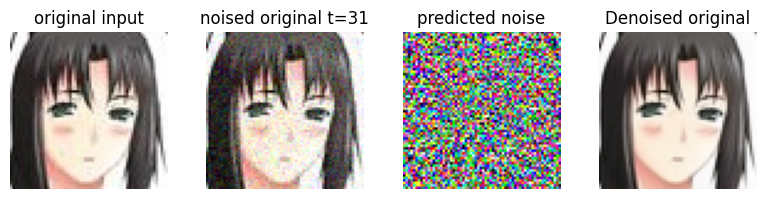

train loss: 0.064664  [48006/72454]
val loss: 0.030082  [48006/72454]
timestep in first x in the batch:  658


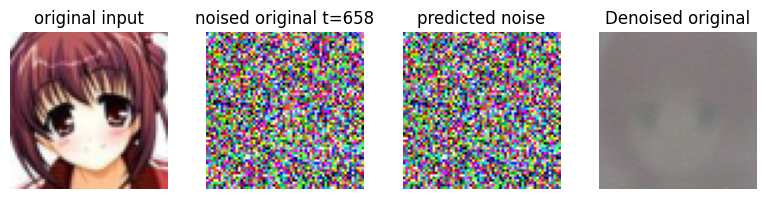

train loss: 0.034776  [52806/72454]
val loss: 0.029381  [52806/72454]
timestep in first x in the batch:  74


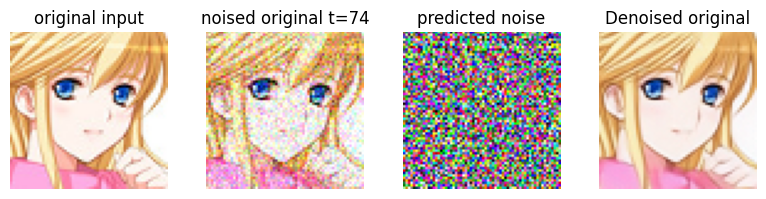

train loss: 0.024787  [57606/72454]
val loss: 0.029473  [57606/72454]
timestep in first x in the batch:  940


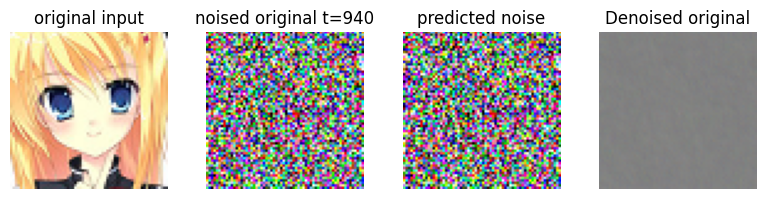

train loss: 0.038233  [62406/72454]
val loss: 0.026386  [62406/72454]
timestep in first x in the batch:  934


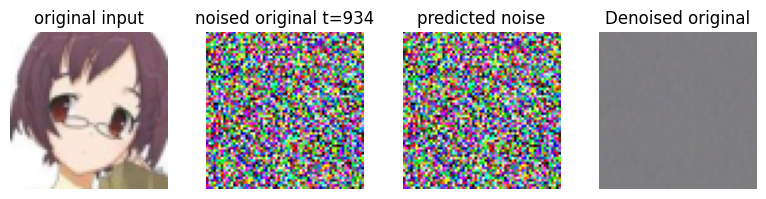

train loss: 0.102565  [67206/72454]
val loss: 0.024126  [67206/72454]
timestep in first x in the batch:  20


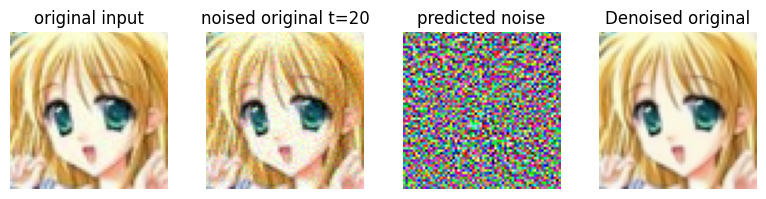

train loss: 0.016384  [72006/72454]
val loss: 0.027365  [72006/72454]
timestep in first x in the batch:  242


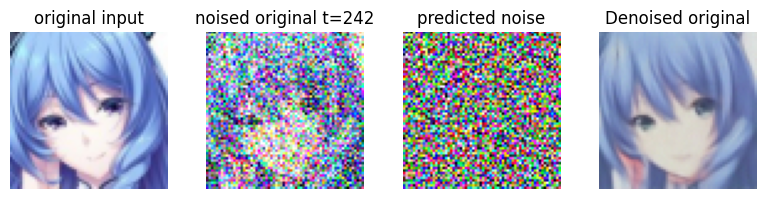

Epoch 5 finished
Model saved as 85M_params_GIGA_DDPM_Unet_ckpt_epoch_5.pth
---------------------------------------------
 EPOCH 6
---------------------------------------------
train loss: 0.015118  [    6/72454]
val loss: 0.027221  [    6/72454]
timestep in first x in the batch:  354


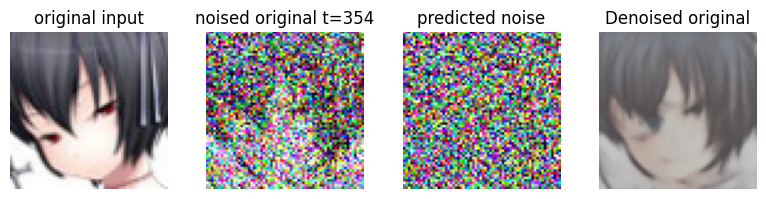

train loss: 0.017404  [ 4806/72454]
val loss: 0.025888  [ 4806/72454]
timestep in first x in the batch:  82


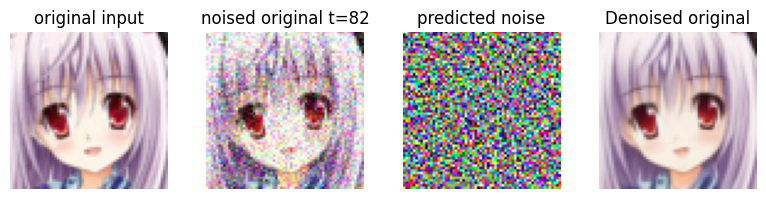

train loss: 0.004703  [ 9606/72454]
val loss: 0.025858  [ 9606/72454]
timestep in first x in the batch:  855


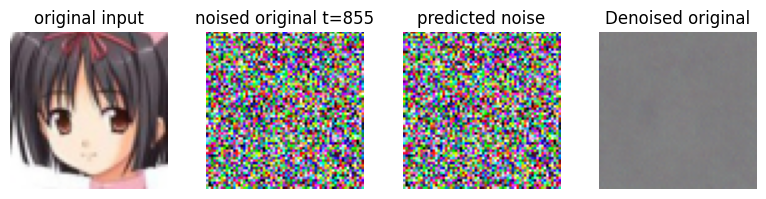

train loss: 0.016803  [14406/72454]
val loss: 0.029505  [14406/72454]
timestep in first x in the batch:  96


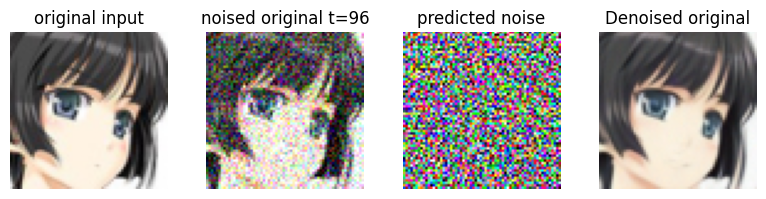

train loss: 0.013325  [19206/72454]
val loss: 0.021352  [19206/72454]
timestep in first x in the batch:  945


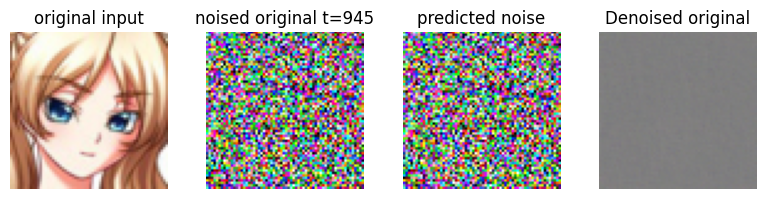

train loss: 0.120718  [24006/72454]
val loss: 0.025948  [24006/72454]
timestep in first x in the batch:  780


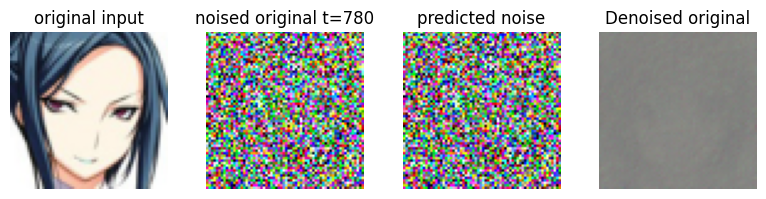

train loss: 0.013901  [28806/72454]
val loss: 0.026117  [28806/72454]
timestep in first x in the batch:  847


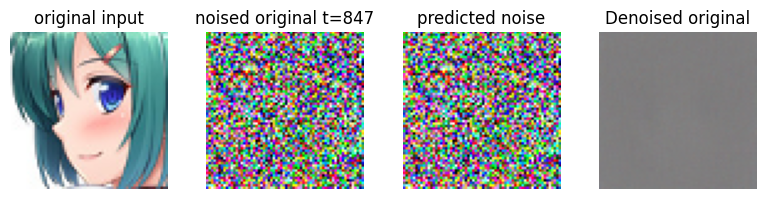

train loss: 0.014947  [33606/72454]
val loss: 0.026148  [33606/72454]
timestep in first x in the batch:  770


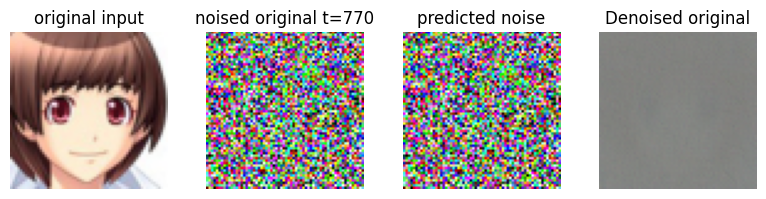

train loss: 0.025795  [38406/72454]
val loss: 0.025151  [38406/72454]
timestep in first x in the batch:  33


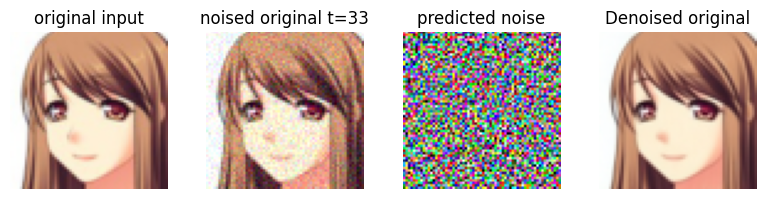

train loss: 0.006558  [43206/72454]
val loss: 0.027425  [43206/72454]
timestep in first x in the batch:  69


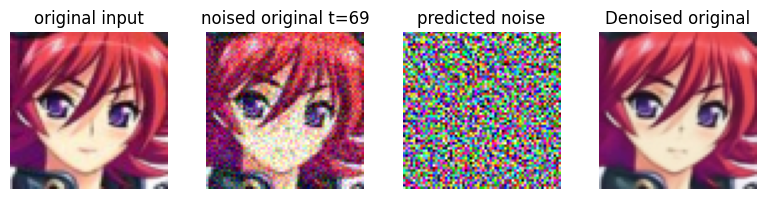

train loss: 0.013367  [48006/72454]
val loss: 0.027709  [48006/72454]
timestep in first x in the batch:  639


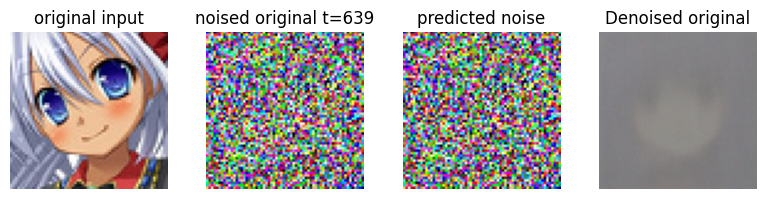

train loss: 0.014752  [52806/72454]
val loss: 0.029115  [52806/72454]
timestep in first x in the batch:  882


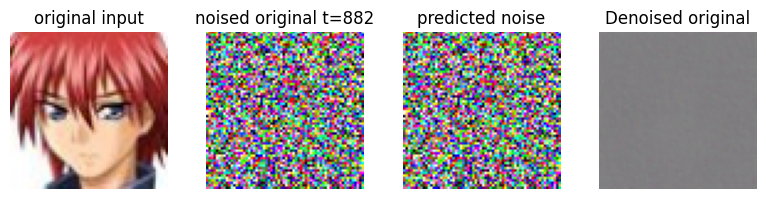

In [ ]:
giga_model_trained = train_model(module=Giga, dataset=dataset, device=device, rand_gen=rand_gen, wandb_logs=True)

## Simpling from the learned distribution

In [ ]:
@torch.no_grad()
def generate(model, shape=(1, 1, 64, 64)):
    x = torch.randn(shape).cuda()
    B = shape[0]    #batch size, number of samples to generate
    # Generate samples by reversing the diffusion process
    for t_step in reversed(range(T)):
        t = torch.full((B,), t_step, dtype=torch.long).to(x.device)
        x = p_sample(model, x, t)
    return x

 ### Saving the notebook.

In [ ]:
from ipylab import JupyterFrontEnd
app = JupyterFrontEnd()
app.commands.execute('docmanager:save')